In [14]:
import numpy as np
import matplotlib.pyplot as plt
import glob
import os
from astropy.io import fits
from astropy.stats import sigma_clipped_stats

In [8]:
workingdir = '/Users/alex/Desktop/A100Observations'
!ls $workingdir

0001.BIAS.fits      0026.FLATB.fits     0051.FLATi.fits     0076.M67.fits
0002.BIAS.fits      0027.FLATB.fits     0052.FLATi.fits     0077.test.fits
0003.BIAS.fits      0028.FLATV.fits     0053.FLATi.fits     0078.M82.fits
0004.BIAS.fits      0029.FLATV.fits     0054.FLATi.fits     0079.M82.fits
0005.BIAS.fits      0030.FLATV.fits     0055.FLATi.fits     0080.M82.fits
0006.BIAS.fits      0031.FLATV.fits     0056.FLATi.fits     0081.M82.fits
0007.BIAS.fits      0032.FLATV.fits     0057.FLATi.fits     0082.FOCUS.fits
0008.BIAS.fits      0033.FLATV.fits     0058.FLATi.fits     0083.FWHMtestr.fits
0009.BIAS.fits      0034.FLATV.fits     0059.FLATi.fits     0084.test.fits
0010.BIAS.fits      0035.FLATV.fits     0060.FLATi.fits     0436.test.fits
0011.BIAS.fits      0036.FLATV.fits     0061.testref.fits   0437.M67.fits
0012.BIAS.fits      0037.FLATV.fits     0062.test.fits      0438.M67.fits
0013.BIAS.fits      0038.FLATV.fits     0063.M67.fits       0439.M67.fits
0014.BIAS.fits      0039.FL

In [9]:
os.chdir(workingdir)

In [10]:
files_all = glob.glob('*fits') #Find all the files that match this pattern
files_BIAS = glob.glob('*BIAS*')
files_FLATS = glob.glob('*FLAT*')
files_ARCS = glob.glob('*COMP*')
files_TEST = glob.glob('*test*')

print(files_BIAS, '\n')
print(files_FLATS, '\n')
print(files_ARCS, '\n')
files_SCI = list(set(files_all)-set(files_BIAS)-set(files_FLATS)-set(files_ARCS)-set(files_TEST))
print(files_SCI)

['0016.BIAS.fits', '0002.BIAS.fits', '0009.BIAS.fits', '0010.BIAS.fits', '0004.BIAS.fits', '0003.BIAS.fits', '0008.BIAS.fits', '0005.BIAS.fits', '0011.BIAS.fits', '0014.BIAS.fits', '0012.BIAS.fits', '0006.BIAS.fits', '0001.BIAS.fits', '0015.BIAS.fits', '0007.BIAS.fits', '0013.BIAS.fits'] 

['0041.FLATr.fits', '0022.FLATB.fits', '0056.FLATi.fits', '0036.FLATV.fits', '0018.FLATB.fits', '0033.FLATV.fits', '0053.FLATi.fits', '0049.FLATr.fits', '0044.FLATr.fits', '0027.FLATB.fits', '0020.FLATB.fits', '0017.FLATB.fits', '0043.FLATr.fits', '0059.FLATi.fits', '0028.FLATV.fits', '0054.FLATi.fits', '0034.FLATV.fits', '0031.FLATV.fits', '0051.FLATi.fits', '0025.FLATB.fits', '0046.FLATr.fits', '0052.FLATi.fits', '0048.FLATr.fits', '0032.FLATV.fits', '0045.FLATr.fits', '0026.FLATB.fits', '0040.FLATr.fits', '0023.FLATB.fits', '0037.FLATV.fits', '0057.FLATi.fits', '0060.FLATi.fits', '0019.FLATB.fits', '0050.FLATi.fits', '0030.FLATV.fits', '0024.FLATB.fits', '0039.FLATr.fits', '0047.FLATr.fits', '0021

In [11]:
def readFits(filename):
    HDUList = fits.open(filename)
    headers = [HDUList[0].header, HDUList[1].header, HDUList[2].header, HDUList[3].header, HDUList[4].header]

    nx, ny = 1024, 1024
    StitchedData = np.zeros((2*nx, 2*ny))
    StitchedData[nx:nx*2,0:ny] = HDUList[2].data[:-1,8:-8]
    StitchedData[0:nx,0:ny] = HDUList[4].data[:-1,8:-8]
    StitchedData[nx:nx*2,ny:ny*2] = HDUList[1].data[:-1,8:-8]
    StitchedData[0:nx,ny:ny*2] = HDUList[3].data[:-1,8:-8]

    return HDUList, headers, StitchedData

In [34]:
junk1, junk2, junk3 = readFits(files_BIAS[0])
nx, ny = junk3.shape

BiasData = np.zeros((nx, ny, len(files_BIAS)))

for i,file in enumerate(files_BIAS):
    HDUList, headers, StitchedData = readFits(file)
    BiasData[:,:,i] = StitchedData

In [35]:
BiasData

array([[[302., 301., 301., ..., 298., 298., 300.],
        [306., 304., 300., ..., 304., 303., 304.],
        [310., 307., 307., ..., 305., 308., 305.],
        ...,
        [306., 308., 306., ..., 309., 306., 306.],
        [303., 303., 304., ..., 302., 305., 304.],
        [300., 298., 298., ..., 300., 300., 299.]],

       [[295., 298., 299., ..., 301., 296., 294.],
        [303., 307., 302., ..., 303., 307., 300.],
        [309., 309., 307., ..., 302., 303., 307.],
        ...,
        [308., 308., 308., ..., 308., 306., 304.],
        [304., 304., 302., ..., 302., 306., 304.],
        [301., 298., 299., ..., 298., 296., 298.]],

       [[300., 303., 300., ..., 297., 299., 301.],
        [303., 306., 303., ..., 303., 302., 300.],
        [305., 308., 306., ..., 307., 306., 307.],
        ...,
        [305., 308., 306., ..., 305., 306., 310.],
        [303., 302., 303., ..., 305., 305., 304.],
        [298., 300., 297., ..., 296., 298., 299.]],

       ...,

       [[302., 308., 305

(array([1., 2., 2., 3., 0., 3., 3., 1., 0., 1.]),
 array([290. , 290.8, 291.6, 292.4, 293.2, 294. , 294.8, 295.6, 296.4,
        297.2, 298. ]),
 <a list of 10 Patch objects>)

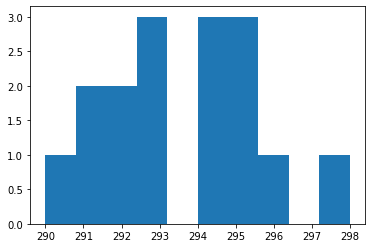

In [36]:
plt.hist(BiasData[40,40,:])

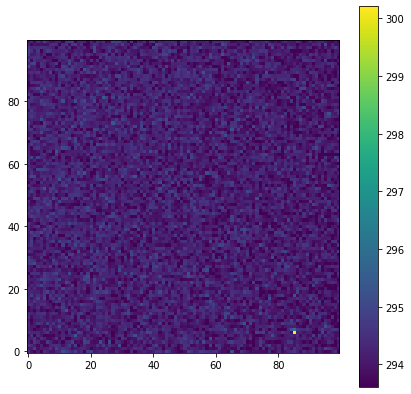

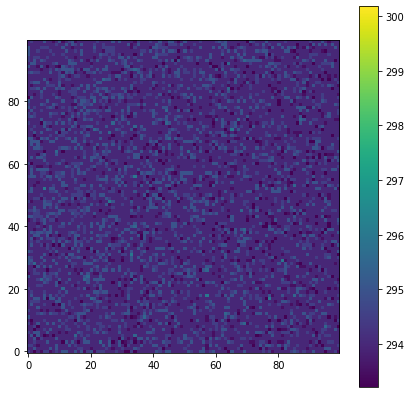

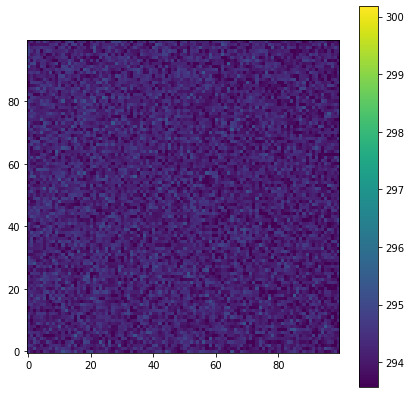

In [37]:
masterBias_mean = np.mean(BiasData, axis=2)
masterBias_med = np.median(BiasData, axis=2)


def highlowreject(BiasData):
    nimage = BiasData.shape[2]
    bias_max = np.max(BiasData, axis=2)#High low rejection 
    bias_min = np.min(BiasData, axis=2)
    masterBias = (np.sum(BiasData, axis=2) - bias_min - bias_max)/(nimage-2)#better than just a mean or median becauase it accounts for cosmic rays
    return masterBias

masterBias = highlowreject(BiasData)

center = [1250, 1800]

def plotit(data, dx=50):
    mean, median, std = sigma_clipped_stats(data)
    plt.figure(figsize=(7,7))
    plt.imshow(data[center[0]-dx:center[0]+dx,center[1]-dx:center[1]+dx],
               vmin = median - 2*std, vmax = median + 3*std, origin='lower')
    plt.colorbar()
    plt.show()

plotit(masterBias_mean)#cosmic ray bottom right
plotit(masterBias_med)
plotit(masterBias)

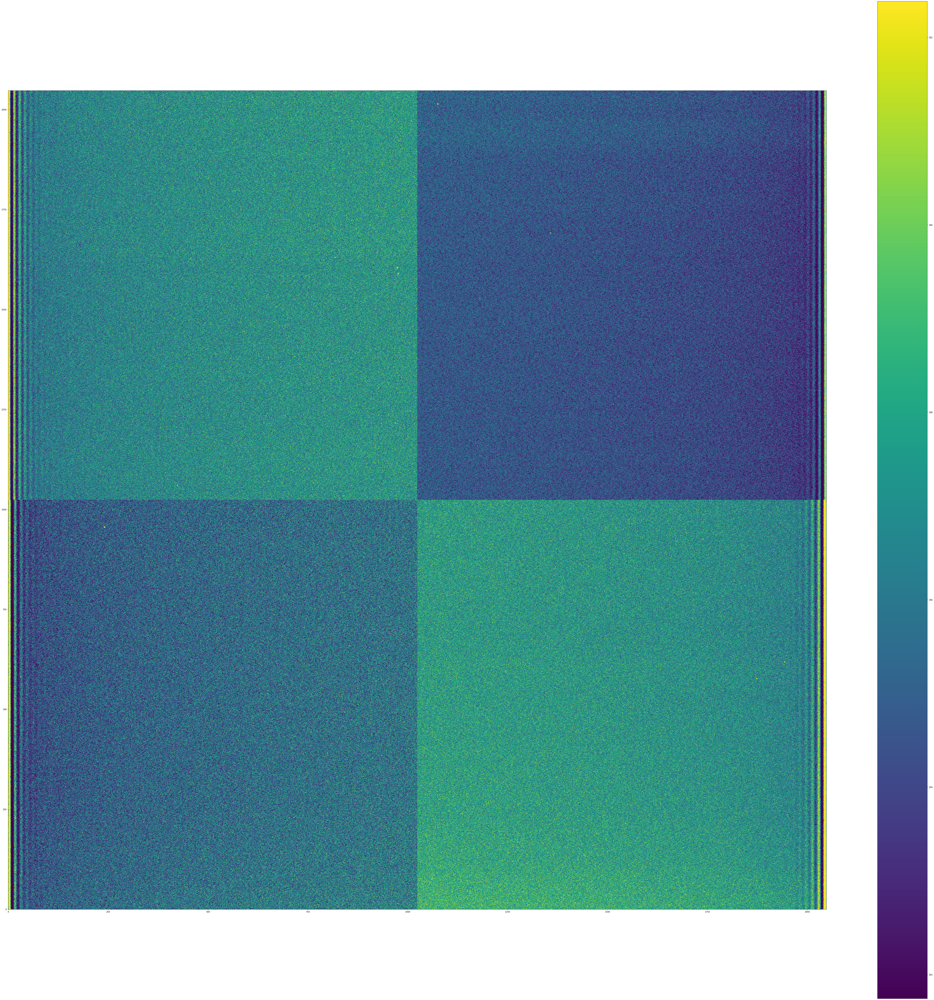

In [38]:
testfile = files_BIAS[0]
testfile = '0063.M67.fits'

HDUList = fits.open(testfile)
header = HDUList[0].header

# nx, ny = 1025, 1040
# nx, ny = 1024, 1024

#just use readfits function here instead
# StitchedData = np.zeros((2*nx, 2*ny))
# StitchedData[nx:nx*2,0:ny] = HDUList[2].data[:-1,8:-8]
# StitchedData[0:nx,0:ny] = HDUList[4].data[:-1,8:-8]
# StitchedData[nx:nx*2,ny:ny*2] = HDUList[1].data[:-1,8:-8]
# StitchedData[0:nx,ny:ny*2] = HDUList[3].data[:-1,8:-8]


mean, median, std = sigma_clipped_stats(StitchedData)
    
plt.figure(figsize=(90,90))                     # set up the plot panel
plt.imshow(StitchedData, vmin = median - 2*std, vmax = median + 3*std, origin='lower')
plt.colorbar()
plt.show()

# mean, median, std = sigma_clipped_stats(HDUList[1].data)
# plt.figure(figsize=(90,7))                     # set up the plot panel
# plt.imshow(HDUList[1].data[-10:,:100], vmin = median - 2*std, vmax = median + 3*std, origin='lower')
# plt.colorbar()
# plt.show()

# print(HDUList[1].data[:-1,8:-8].shape)

# HDUList[1].data[:-1,8:-8]

In [39]:
# for i in np.arange(4):
#     data = HDUList[i+1].data
    
#     StitchedData[0:nx,0:ny] = data
    
#     mean, median, std = sigma_clipped_stats(data)
    
#     plt.figure(figsize=(90,7))                     # set up the plot panel
#     plt.imshow(data, vmin = median - 2*std, vmax = median + 3*std, origin='lower')
#     plt.colorbar()
#     plt.show()

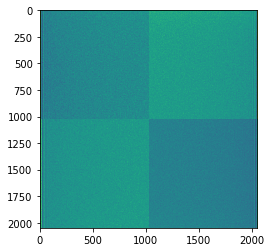

In [40]:
plt.imshow(masterBias)


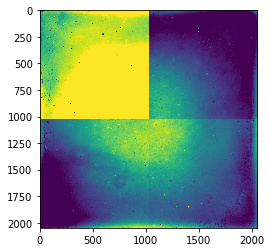

In [54]:
files_FLATS = glob.glob('*FLATi*')

FlatsData = np.zeros((nx, ny, len(files_FLATS)))

for i,file in enumerate(files_FLATS):
    HDUList, headers, StitchedData = readFits(file)
    StitchedData = StitchedData - masterBias
    FlatsData[:,:,i] = StitchedData/np.mean(StitchedData)
    
iFlat = highlowreject(FlatsData)    

plt.imshow(iFlat, vmin = .9, vmax = 1.1)



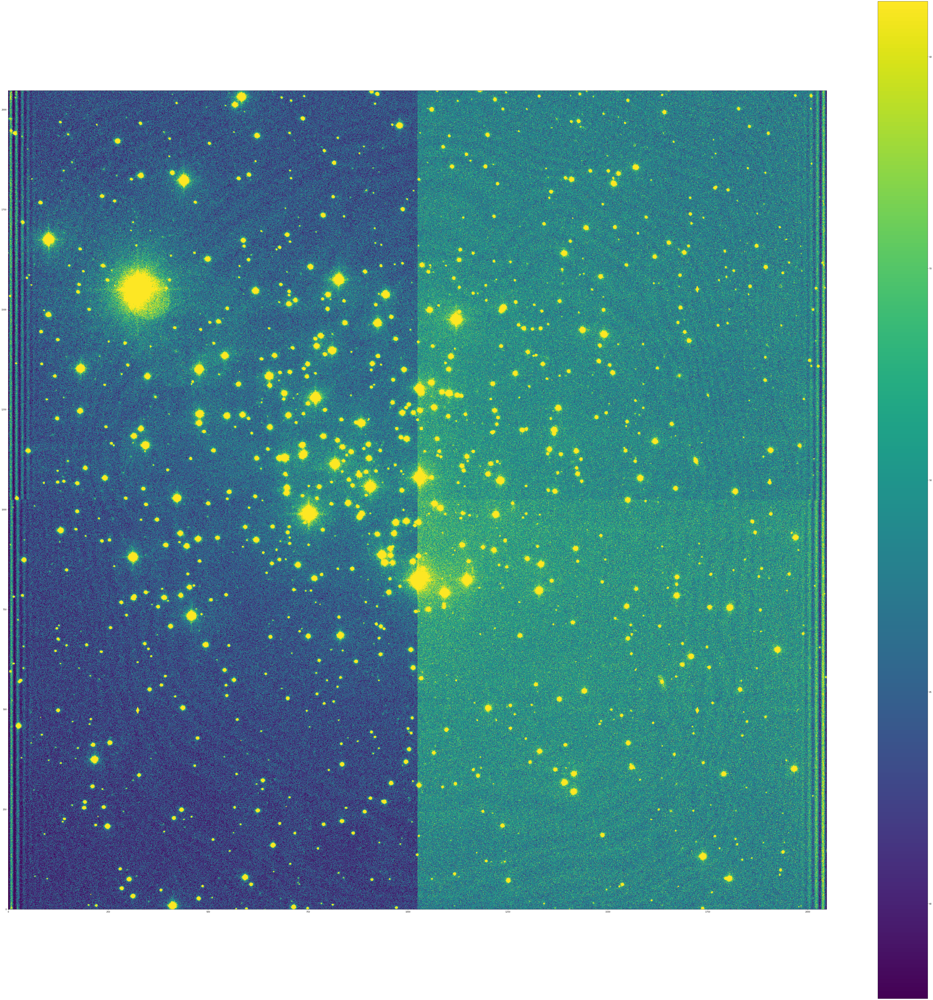

In [56]:
sD1, sD2, sD3 = readFits("/Users/alex/Desktop/A100Observations/0443.M67.fits")

calibImage = (sD3 - masterBias) / iFlat

mean, median, std = sigma_clipped_stats(calibImage)
    
plt.figure(figsize=(90,90))                     # set up the plot panel
plt.imshow(calibImage, vmin = median - 2*std, vmax = median + 3*std, origin='lower')
plt.colorbar()
plt.show()
#ripples are called fringing- interference within the telescope - don't see it in rband or gband
#start with rband

In [73]:
print(HDUList[1].header['DATASEC'])
print(HDUList[2].header['DATASEC'])
print(HDUList[3].header['DATASEC'])
print(HDUList[4].header['DATASEC'])

[9:1032,1:1024]
[9:1032,1:1024]
[9:1032,1:1024]
[9:1032,1:1024]
